<a href="https://colab.research.google.com/github/trm2yf/STC_Capstone/blob/main/Siamese_deep_learning_for_satellite_image_processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Deep learning for satellite image processing

In [ ]:
!python --version
!pip uninstall -y typing
!pip install torch torchvision git+https://github.com/BloodAxe/catalyst git+https://github.com/BloodAxe/pytorch-toolbelt albumentations timm==0.2.1 iterative-stratification

Python 3.7.11
  Cloning https://github.com/BloodAxe/catalyst to /tmp/pip-req-build-fuw5ipnu
  Running command git clone -q https://github.com/BloodAxe/catalyst /tmp/pip-req-build-fuw5ipnu
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Cloning https://github.com/BloodAxe/pytorch-toolbelt to /tmp/pip-req-build-bvw4uw2l
  Running command git clone -q https://github.com/BloodAxe/pytorch-toolbelt /tmp/pip-req-build-bvw4uw2l
     |████████████████████████████████| 225 kB 2.9 MB/s 
     |████████████████████████████████| 170 kB 13.4 MB/s 
     |████████████████████████████████| 124 kB 13.4 MB/s 
     |████████████████████████████████| 63 kB 2.0 MB/s 
     |████████████████████████████████| 631 kB 11.2 MB/s 
  Created wheel for catalyst: filename=catalyst-20.10.1-py3-none-any.whl size=511726 sha256=dffad7fe24aff953c8475e30e4f14a3a86d58cc0ef5bda342cabf71dd207a448
  Stored in directory: /tmp/pip-ephem-wheel-cache-_6

In [ ]:
import os
import cv2
import pandas as pd
import numpy as np
import gc
import torch

import albumentations as A

from typing import Union, List, Optional, Dict, Callable

from pytorch_toolbelt.utils import fs

from pytorch_toolbelt.utils import fs
from pytorch_toolbelt.utils.torch_utils import tensor_from_rgb_image, rgb_image_from_tensor, to_numpy, image_to_tensor 

from sklearn.utils import compute_sample_weight, compute_class_weight
from sklearn.model_selection import train_test_split

from collections import OrderedDict
from functools import partial

from pytorch_toolbelt.utils import maybe_cuda, count_parameters
from pytorch_toolbelt.modules import conv1x1, UnetBlock, ACT_RELU, ABN, ACT_SWISH
from pytorch_toolbelt.modules import encoders as E
from pytorch_toolbelt.modules.decoders import UNetDecoder
from pytorch_toolbelt.modules.encoders import EncoderModule, Resnet18Encoder, Resnet34Encoder, Resnet50Encoder, Resnet101Encoder, SEResNeXt50Encoder, DenseNet121Encoder
from pytorch_toolbelt.modules.encoders.timm import B0Encoder, B2Encoder, B3Encoder, B4Encoder, B6Encoder, DPN68Encoder, SKResNet18Encoder, SKResNeXt50Encoder
from pytorch_toolbelt.utils.catalyst import F1ScoreCallback

from torch import nn, Tensor
from torch.nn import functional as F
from torch.optim import SGD, Adam, RMSprop, AdamW
from torch.utils.data import Dataset, WeightedRandomSampler, ConcatDataset, DataLoader

from catalyst.dl import (
    SupervisedRunner,
    SchedulerCallback,
    CriterionCallback
)
from catalyst.utils import set_global_seed
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#copy saved model/logs to cwd
!cp -r "/content/drive/MyDrive/Xview2_Data/pngs/logs" ./

##Build Dataset

In [ ]:
DATA_DIR = "../input/xview2-damage-assessment"
DATA_DIR = "/content/drive/MyDrive/Xview2_Data/pngs"

os.listdir(DATA_DIR)

['hold', 'tier3', 'test', 'train', 'train.csv', 'logs']

In [ ]:
df = pd.read_csv(os.path.join(DATA_DIR, 'train.csv'))
df

,destroyed_buildings,destroyed_pixels,event_name,event_type,folder,image_fname,image_id,light_damaged_buildings,light_damaged_pixels,mask_fname,medium_damaged_buildings,medium_damaged_pixels,non_damaged_buildings,non_damaged_pixels,sample_id
0,0,0,guatemala-volcano,post,train,train\images\guatemala-volcano_00000000_post_d...,guatemala-volcano_00000000_post_disaster,0,0,train\masks\guatemala-volcano_00000000_post_di...,0,0,9,15938,0
1,0,0,guatemala-volcano,pre,train,train\images\guatemala-volcano_00000000_pre_di...,guatemala-volcano_00000000_pre_disaster,0,0,train\masks\guatemala-volcano_00000000_pre_dis...,0,0,9,15965,0
2,0,0,guatemala-volcano,post,train,train\images\guatemala-volcano_00000001_post_d...,guatemala-volcano_00000001_post_disaster,4,2560,train\masks\guatemala-volcano_00000001_post_di...,0,0,0,0,1
3,0,0,guatemala-volcano,pre,train,train\images\guatemala-volcano_00000001_pre_di...,guatemala-volcano_00000001_pre_disaster,0,0,train\masks\guatemala-volcano_00000001_pre_dis...,0,0,4,2567,1
4,1,2498,guatemala-volcano,post,train,train\images\guatemala-volcano_00000002_post_d...,guatemala-volcano_00000002_post_disaster,0,0,train\masks\guatemala-volcano_00000002_post_di...,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18331,0,0,woolsey-fire,pre,tier3,tier3\images\woolsey-fire_00000875_pre_disaste...,woolsey-fire_00000875_pre_disaster,0,0,tier3\masks\woolsey-fire_00000875_pre_disaster...,0,0,0,0,875
18332,0,0,woolsey-fire,post,tier3,tier3\images\woolsey-fire_00000876_post_disast...,woolsey-fire_00000876_post_disaster,0,0,tier3\masks\woolsey-fire_00000876_post_disaste...,0,0,0,0,876
18333,0,0,woolsey-fire,pre,tier3,tier3\images\woolsey-fire_00000876_pre_disaste...,woolsey-fire_00000876_pre_disaster,0,0,tier3\masks\woolsey-fire_00000876_pre_disaster...,0,0,0,0,876
18334,0,0,woolsey-fire,post,tier3,tier3\images\woolsey-fire_00000877_post_disast...,woolsey-fire_00000877_post_disaster,0,0,tier3\masks\woolsey-fire_00000877_post_disaste...,0,0,0,0,877


In [ ]:

df = df.drop(columns=["light_damaged_pixels",
                      "destroyed_pixels",
                      "medium_damaged_pixels",
                      "non_damaged_pixels", 
                      "folder"])

df["key"] = df["event_name"] + df["sample_id"].apply(str)
df

,destroyed_buildings,event_name,event_type,image_fname,image_id,light_damaged_buildings,mask_fname,medium_damaged_buildings,non_damaged_buildings,sample_id,key
0,0,guatemala-volcano,post,train\images\guatemala-volcano_00000000_post_d...,guatemala-volcano_00000000_post_disaster,0,train\masks\guatemala-volcano_00000000_post_di...,0,9,0,guatemala-volcano0
1,0,guatemala-volcano,pre,train\images\guatemala-volcano_00000000_pre_di...,guatemala-volcano_00000000_pre_disaster,0,train\masks\guatemala-volcano_00000000_pre_dis...,0,9,0,guatemala-volcano0
2,0,guatemala-volcano,post,train\images\guatemala-volcano_00000001_post_d...,guatemala-volcano_00000001_post_disaster,4,train\masks\guatemala-volcano_00000001_post_di...,0,0,1,guatemala-volcano1
3,0,guatemala-volcano,pre,train\images\guatemala-volcano_00000001_pre_di...,guatemala-volcano_00000001_pre_disaster,0,train\masks\guatemala-volcano_00000001_pre_dis...,0,4,1,guatemala-volcano1
4,1,guatemala-volcano,post,train\images\guatemala-volcano_00000002_post_d...,guatemala-volcano_00000002_post_disaster,0,train\masks\guatemala-volcano_00000002_post_di...,0,0,2,guatemala-volcano2
...,...,...,...,...,...,...,...,...,...,...,...
18331,0,woolsey-fire,pre,tier3\images\woolsey-fire_00000875_pre_disaste...,woolsey-fire_00000875_pre_disaster,0,tier3\masks\woolsey-fire_00000875_pre_disaster...,0,0,875,woolsey-fire875
18332,0,woolsey-fire,post,tier3\images\woolsey-fire_00000876_post_disast...,woolsey-fire_00000876_post_disaster,0,tier3\masks\woolsey-fire_00000876_post_disaste...,0,0,876,woolsey-fire876
18333,0,woolsey-fire,pre,tier3\images\woolsey-fire_00000876_pre_disaste...,woolsey-fire_00000876_pre_disaster,0,tier3\masks\woolsey-fire_00000876_pre_disaster...,0,0,876,woolsey-fire876
18334,0,woolsey-fire,post,tier3\images\woolsey-fire_00000877_post_disast...,woolsey-fire_00000877_post_disaster,0,tier3\masks\woolsey-fire_00000877_post_disaste...,0,0,877,woolsey-fire877


In [ ]:
df_pre = df[df["event_type"] == "pre"]\
    .rename(columns={"image_fname": "image_fname_pre", "mask_fname": "mask_fname_pre"})\
    .drop(columns=["event_type", "image_id", "sample_id",
                      "light_damaged_buildings",
                      "destroyed_buildings",
                      "medium_damaged_buildings",
                      "non_damaged_buildings"])
df_post = df[df["event_type"] == "post"]\
    .rename(columns={"image_fname": "image_fname_post", "mask_fname": "mask_fname_post"})\
    .drop(columns=["event_name", "image_id", "event_type", "sample_id"])
df_all = df_pre.merge(df_post, on='key')
#df_all["total_buildings"] = df_all["destroyed_buildings"] + df_all["medium_damaged_buildings"] + df_all["light_damaged_buildings"] + df_all["non_damaged_buildings"]
df_all["damaged_buildings"] = df_all["destroyed_buildings"] + df_all["medium_damaged_buildings"] + df_all["light_damaged_buildings"]
print("Total samples", len(df_all))



Total samples 9168


**Disclaimer**: We have a little more than 9K pairs of images, which is quite a lot for training image segmentation model. However, Kaggle environment offers only dual-core CPU, which becomes a bottleneck in our training pipeline. So for the sake of staying within workshop time limit, we train our model using only a small part of the dataset - 300 train images and 50 test images.

No doubt, this small number of samples is anywhere close to enough number of training samples, however it is sufficient to evaluate different ideas in a controlled environment (With fixed random seed and determinictic GPU execution mode to ensure we're always training on exactly the same data samples). I encourage you to run these experiments on full training set and check whether our assumptions & findings holds true for larger number of samples.

In [ ]:
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold

df_all = df_all[df_all["damaged_buildings"] > 0].copy()
print("Samples with damaged buildings", len(df_all))

#train_df, valid_df = train_test_split(df_all, stratify=df_all["event_name"], test_size=0.2, shuffle=True, random_state=42)


mskf = MultilabelStratifiedKFold(n_splits=4, shuffle=True, random_state=0)
stratify_label = np.stack([
    df_all["non_damaged_buildings"].values > 0,
    df_all["light_damaged_buildings"].values > 0,
    df_all["medium_damaged_buildings"].values > 0,
    df_all["destroyed_buildings"].values > 0,
    
], axis=-1)

print(stratify_label.shape)

train_index, valid_index = next(mskf.split(df_all, stratify_label))

train_df = df_all.iloc[train_index]
valid_df = df_all.iloc[valid_index]

train_df = train_df.sort_values(by="damaged_buildings", ascending=False)[:300]
valid_df = valid_df.sort_values(by="damaged_buildings", ascending=False)[:60]
holdout_df = valid_df[50:]
valid_df = valid_df[:50]

print("Train samples", len(train_df))
print("Valid samples", len(valid_df))
print("Holdout samples", len(holdout_df))

train_img_pre = train_df["image_fname_pre"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
train_img_post = train_df["image_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
train_mask_post = train_df["mask_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()

valid_img_pre = valid_df["image_fname_pre"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
valid_img_post = valid_df["image_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
valid_mask_post = valid_df["mask_fname_post"].apply(lambda x: os.path.abspath(os.path. os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()

holdout_img_pre = holdout_df["image_fname_pre"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
holdout_img_post = holdout_df["image_fname_post"].apply(lambda x: os.path.abspath(os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()
holdout_mask_post = holdout_df["mask_fname_post"].apply(lambda x: os.path.abspath(os.path. os.path.join(DATA_DIR, x.replace("\\", "/")))).tolist()

Samples with damaged buildings 3240
(3240, 4)
Train samples 300
Valid samples 50
Holdout samples 10


In [ ]:
train_df

,event_name,image_fname_pre,mask_fname_pre,key,destroyed_buildings,image_fname_post,light_damaged_buildings,mask_fname_post,medium_damaged_buildings,non_damaged_buildings,damaged_buildings
2946,joplin-tornado,tier3\images\joplin-tornado_00000147_pre_disas...,tier3\masks\joplin-tornado_00000147_pre_disast...,joplin-tornado147,285,tier3\images\joplin-tornado_00000147_post_disa...,4,tier3\masks\joplin-tornado_00000147_post_disas...,18,1,307
746,hurricane-matthew,train\images\hurricane-matthew_00000156_pre_di...,train\masks\hurricane-matthew_00000156_pre_dis...,hurricane-matthew156,88,train\images\hurricane-matthew_00000156_post_d...,83,train\masks\hurricane-matthew_00000156_post_di...,115,13,286
872,hurricane-matthew,train\images\hurricane-matthew_00000368_pre_di...,train\masks\hurricane-matthew_00000368_pre_dis...,hurricane-matthew368,20,train\images\hurricane-matthew_00000368_post_d...,222,train\masks\hurricane-matthew_00000368_post_di...,39,11,281
859,hurricane-matthew,train\images\hurricane-matthew_00000346_pre_di...,train\masks\hurricane-matthew_00000346_pre_dis...,hurricane-matthew346,0,train\images\hurricane-matthew_00000346_post_d...,279,train\masks\hurricane-matthew_00000346_post_di...,0,4,279
834,hurricane-matthew,train\images\hurricane-matthew_00000296_pre_di...,train\masks\hurricane-matthew_00000296_pre_dis...,hurricane-matthew296,20,train\images\hurricane-matthew_00000296_post_d...,215,train\masks\hurricane-matthew_00000296_post_di...,35,18,270
...,...,...,...,...,...,...,...,...,...,...,...
573,hurricane-harvey,train\images\hurricane-harvey_00000392_pre_dis...,train\masks\hurricane-harvey_00000392_pre_disa...,hurricane-harvey392,1,train\images\hurricane-harvey_00000392_post_di...,0,train\masks\hurricane-harvey_00000392_post_dis...,36,0,37
263,hurricane-florence,train\images\hurricane-florence_00000428_pre_d...,train\masks\hurricane-florence_00000428_pre_di...,hurricane-florence428,0,train\images\hurricane-florence_00000428_post_...,0,train\masks\hurricane-florence_00000428_post_d...,37,0,37
3585,nepal-flooding,tier3\images\nepal-flooding_00000119_pre_disas...,tier3\masks\nepal-flooding_00000119_pre_disast...,nepal-flooding119,3,tier3\images\nepal-flooding_00000119_post_disa...,24,tier3\masks\nepal-flooding_00000119_post_disas...,10,17,37
1730,palu-tsunami,train\images\palu-tsunami_00000160_pre_disaste...,train\masks\palu-tsunami_00000160_pre_disaster...,palu-tsunami160,32,train\images\palu-tsunami_00000160_post_disast...,0,train\masks\palu-tsunami_00000160_post_disaste...,5,67,37


In [ ]:
print(train_df["event_name"].unique())

['joplin-tornado' 'hurricane-matthew' 'hurricane-harvey' 'moore-tornado'
 'santa-rosa-wildfire' 'palu-tsunami' 'hurricane-michael'
 'tuscaloosa-tornado' 'nepal-flooding' 'woolsey-fire' 'hurricane-florence'
 'socal-fire' 'lower-puna-volcano' 'portugal-wildfire']


In [ ]:
INPUT_IMAGE_KEY = "image"
INPUT_INDEX_KEY = "index"

INPUT_IMAGE_PRE_KEY = "image_pre"
INPUT_IMAGE_POST_KEY = "image_post"

INPUT_IMAGE_ID_KEY = "image_id"
INPUT_BUILDINGS_MASK_KEY = "buildings_mask"
INPUT_DAMAGE_MASK_KEY = "damage_mask"


OUTPUT_DAMAGE_MASK_KEY = "predicted_damage_mask"

def read_image_rgb(fname):
    image = cv2.imread(fname)[..., ::-1]
    if image is None:
        raise FileNotFoundError(fname)
    return image


def read_mask(fname):
    from PIL import Image
    mask = np.array(Image.open(fname))  # Read using PIL since it supports palletted image
    if len(mask.shape) == 3:
        mask = np.squeeze(mask, axis=-1)

    return mask
    
def overlay_damage_mask(image, mask):
    overlay = image.copy()
    overlay[mask == 1] = (0,   255, 0) # Regular buildingn are green
    overlay[mask == 2] = (255, 255, 0) # Destroyed buildings are yellow
    overlay[mask == 3] = (255,  69, 0) # Destroyed buildings are orange
    overlay[mask == 4] = (255,   0, 0) # Destroyed buildings are red
    return cv2.addWeighted(overlay, 0.5, image, 0.5, 0, dtype=cv2.CV_8U)

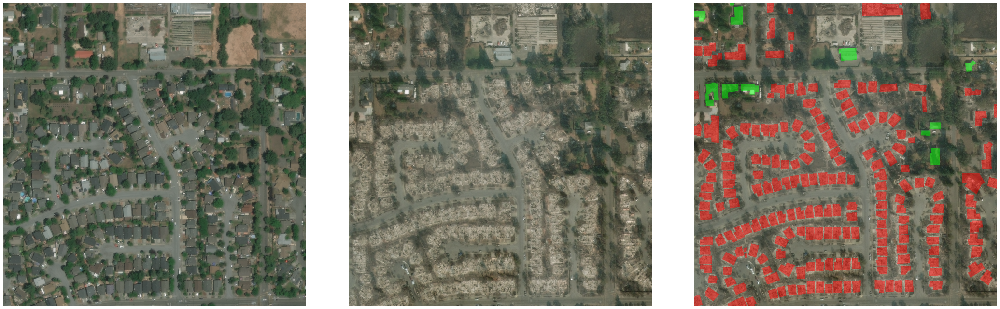

In [ ]:
import matplotlib.pyplot as plt

f, ax = plt.subplots(1,3, figsize=(30,9))
ax[0].imshow(read_image_rgb(train_img_pre[16]))
ax[0].axis('off')
ax[1].imshow(read_image_rgb(train_img_post[16]))
ax[1].axis('off')
ax[2].imshow(overlay_damage_mask(
    read_image_rgb(train_img_post[16]),
    read_mask(train_mask_post[16])
))
ax[2].axis('off')
f.tight_layout()
f.show()

# Image Augmentations
Since we are only using part of the training data this is even more improtant



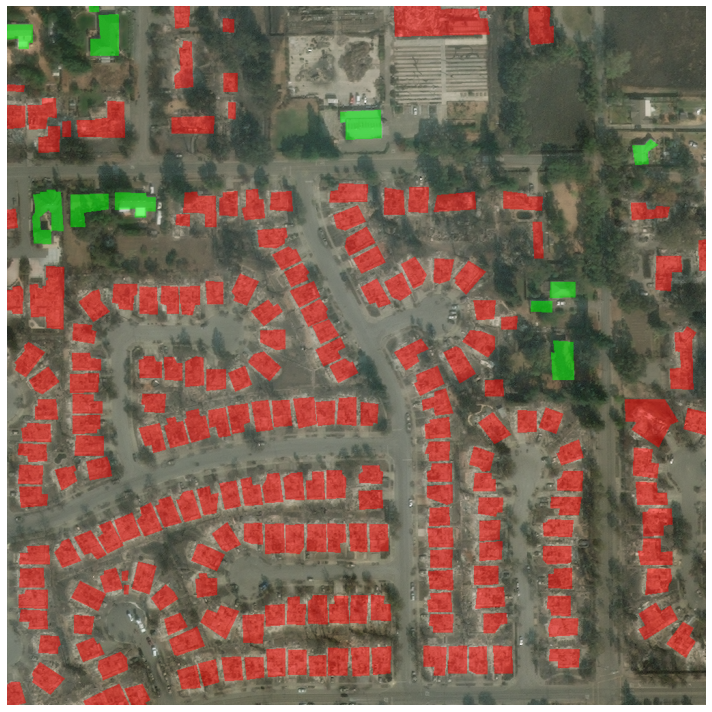

In [ ]:
def show_image(image):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
sample_image = read_image_rgb(train_img_post[16])
sample_mask = read_mask(train_mask_post[16])

show_image(overlay_damage_mask(sample_image, sample_mask))

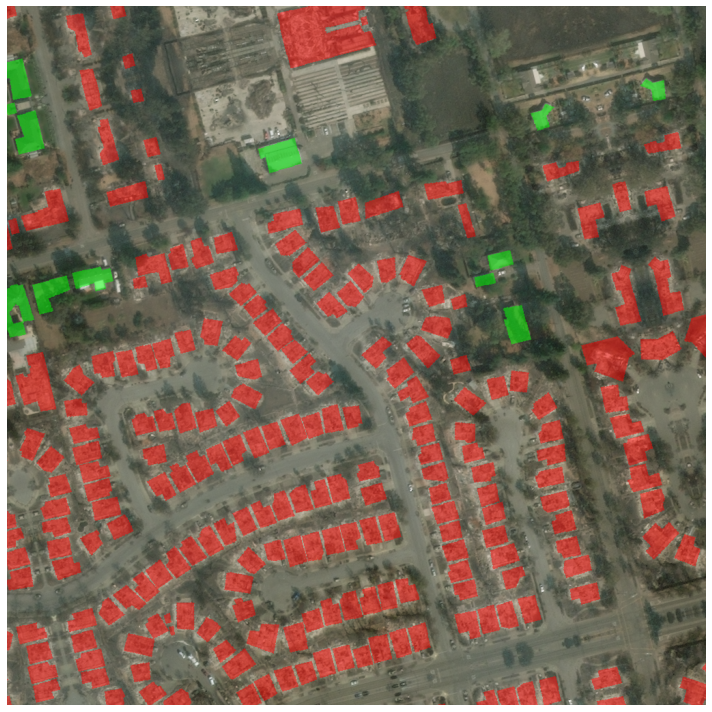

In [ ]:
transform = A.ShiftScaleRotate(scale_limit=0.1, rotate_limit=15, p=1)
augmented = transform(image=sample_image, mask=sample_mask)

show_image(overlay_damage_mask(augmented["image"], augmented["mask"]))


Awesome! Now, let's apply several augmentations sequentially. With Albumentations you can write really sophisticated augmentations. Here we use A.Compose to perform sequential composition of two augmentations: 

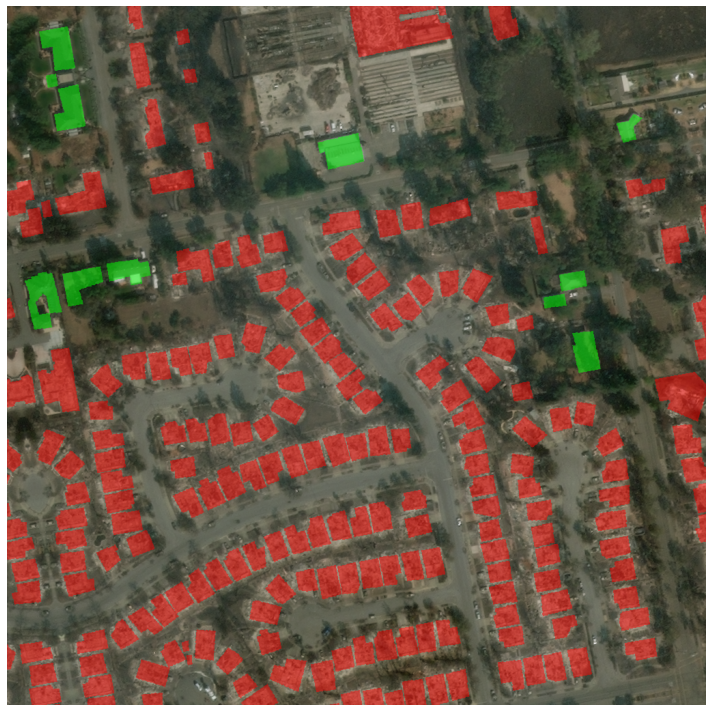

In [ ]:
sample_image = read_image_rgb(train_img_post[16])
sample_mask = read_mask(train_mask_post[16])

transform = A.Compose([
    A.ShiftScaleRotate(scale_limit=0.5, rotate_limit=15, p=1, border_mode=cv2.BORDER_REFLECT),
    A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=1),
])

augmented = transform(image=sample_image, mask=sample_mask)

show_image(overlay_damage_mask(augmented["image"], augmented["mask"]))

**Task**: Try adjusting parameters for `A.RandomShiftScale` and `A.RandomBrightnessContrast` and see how it affects the augmented image. Try to find boundary, where generated images are "way too far off" from the original. 

## Training augmentations

Pro Tip: Try playing with `A.Posterize`, `A.CLAHE`, `A.HueSaturationValue` for color augmentations and `A.MaskDropout`, `A.ElasticTransform` and `A.RandomGridShuffle` for spatial augmentations. See https://github.com/albumentations-team/albumentations for all showsace notebooks.

In [ ]:
color_augmentations = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),
    A.RandomGamma(gamma_limit=(90, 110)),
    A.Normalize()
])


spatial_augmentations = A.Compose([
    # Random crop training samples to 512x512 patches
    A.RandomSizedCrop((512-64, 512+64), 512, 512),
    # D4
    A.RandomRotate90(p=1),
    A.Transpose(p=0.5),
    # Random rotate
    A.ShiftScaleRotate(
        shift_limit=0.05,
        scale_limit=0.1,
        rotate_limit=5,
        border_mode=cv2.BORDER_CONSTANT,
        #value=0,
        #mask_value=0,
    ),    
])

Now it's time to write our dataset class. In PyTorch, we have a concept of the Dataset. It's contract to provide training & validation samples during the training loop. Each sample in our dataset is a pair of images (corresponding to pre- and post- event photo of the area) and corresponding damage mask. Pre- and post- images are already aligned. Typicaly, segmentation models works with only one image, but we can 'pretend' we have only one image by concatenating then via channels dimension. So instead of having two RGB images we will get one 6-channel RGBRGB image. If necessary, we can always split it back into two images inside the model.



In [ ]:
class ImageMaskDataset(Dataset):
    def __init__(
        self,
        pre_image_filenames: List[str],
        post_image_filenames: List[str],
        post_mask_filenames: Optional[List[str]],
        spatial_transform: A.Compose,
        color_transform: A.Compose = None,
    ):
        assert len(pre_image_filenames) == len(post_image_filenames)

        self.pre_image_filenames = pre_image_filenames
        self.post_image_filenames = post_image_filenames
        self.post_mask_filenames = post_mask_filenames

        self.spatial_transform = spatial_transform
        self.color_transform = color_transform

    def __len__(self):
        return len(self.pre_image_filenames)

    def __getitem__(self, index):
        pre_image = read_image_rgb(self.pre_image_filenames[index]) # 1024x1024x3
        post_image = read_image_rgb(self.post_image_filenames[index]) # 1024x1024x3
        mask = read_mask(self.post_mask_filenames[index]) # 1024x1024
        
        if self.color_transform is not None:
            pre_image = self.color_transform(image=pre_image)["image"]
            post_image = self.color_transform(image=post_image)["image"]

        image = np.dstack([pre_image, post_image]) # 1024x1024x6
        
        if self.spatial_transform is not None:
            data = self.spatial_transform(image=image, mask=mask)
            image = data["image"]
            mask = data["mask"]
            
        sample = {
            INPUT_INDEX_KEY: index,
            INPUT_IMAGE_ID_KEY: fs.id_from_fname(self.pre_image_filenames[index]),
            INPUT_IMAGE_KEY: image_to_tensor(image),
            INPUT_BUILDINGS_MASK_KEY: torch.from_numpy(mask > 0).long(),
            INPUT_DAMAGE_MASK_KEY: torch.from_numpy(mask).long()
        }

        return sample


In [ ]:
#none augmented
train_ds = ImageMaskDataset(
    train_img_pre,
    train_img_post,
    train_mask_post,#
    #color_transform=A.Normalize(),
    spatial_transform=spatial_augmentations,
    color_transform=color_augmentations
)
valid_ds = ImageMaskDataset(
    valid_img_pre,
    valid_img_post,
    valid_mask_post,
    color_transform=A.Normalize(),
    spatial_transform=None,
)

print(len(train_ds), len(valid_ds))

300 50


In [ ]:
def show_sample(sample: Dict[str, Tensor]):    
    image_pre = rgb_image_from_tensor(sample[INPUT_IMAGE_KEY][0:3])
    image_post = rgb_image_from_tensor(sample[INPUT_IMAGE_KEY][3:6])
    damage_mask = to_numpy(sample[INPUT_DAMAGE_MASK_KEY])
    
    f, ax = plt.subplots(1,3, figsize=(30,9))
    ax[0].imshow(image_pre)
    ax[0].axis('off')
    ax[1].imshow(image_post)
    ax[1].axis('off')
    ax[2].imshow(overlay_damage_mask(image_post, damage_mask))
    ax[2].axis('off')
    f.tight_layout()
    f.show()

In [ ]:
# from collections import OrderedDict
# from functools import partial
# from typing import Union, List, Dict

# from pytorch_toolbelt.modules import conv1x1, UnetBlock, ACT_RELU, ABN, ACT_SWISH
# from pytorch_toolbelt.modules import encoders as E
# from pytorch_toolbelt.modules.decoders import UNetDecoder
# from pytorch_toolbelt.modules.encoders import EncoderModule
# from pytorch_toolbelt.modules.encoders.timm import *

# from torch import nn, Tensor
# from torch.nn import functional as F


# class UnetSegmentationModel(nn.Module):
#     def __init__(
#         self,
#         encoder: EncoderModule,
#         unet_channels: Union[int, List[int]],
#         num_classes: int = 1,
#         dropout=0.25,
#         full_size_mask=True,
#         activation=ACT_RELU,
#         upsample_block=nn.UpsamplingNearest2d,
#         need_supervision_masks=False,
#         last_upsample_block=None,
#     ):
#         super().__init__()
#         self.encoder = encoder

#         abn_block = partial(ABN, activation=activation)
#         self.decoder = UNetDecoder(
#             feature_maps=encoder.channels,
#             decoder_features=unet_channels,
#             unet_block=partial(UnetBlock, abn_block=abn_block),
#             upsample_block=upsample_block,
#         )

#         self.mask = nn.Sequential(
#             OrderedDict([("drop", nn.Dropout2d(dropout)), ("conv", conv1x1(unet_channels[0], num_classes))])
#         )


#     def forward(self, x: Tensor) -> Dict[str, Tensor]:
#         x_size = x.size()
#         x = self.encoder(x)
#         x = self.decoder(x)

#         # Decode mask
#         mask = self.mask(x[0])
#         mask = F.interpolate(mask, size=x_size[2:], mode="bilinear", align_corners=False)

#         output = {OUTPUT_DAMAGE_MASK_KEY: mask}
#         return output

    
# def b4_unet32(input_channels=6, num_classes=5, dropout=0.1, pretrained=True):
#     # We take outputs of stages 1,2,3,4 which corresponds to strides 4,8,16,32
#     encoder = B4Encoder(pretrained=pretrained, layers=[1,2,3,4])
#     if input_channels != 3:
#         encoder.change_input_channels(input_channels)

#     return UnetSegmentationModel(
#         encoder, num_classes=num_classes, unet_channels=[32, 64, 128], activation=ACT_SWISH, dropout=dropout
#     )

# Training time!

There are key componenets, that you need to pass to Catalyst runner - datasets, model, criterion and optimizer.

In [ ]:
DEFAULT_LR = 1e-3
DEFAULT_NUM_EPOCHS = 30
DEFAULT_BATCH_SIZE = 10
DEFAULT_NUM_WORKERS = 2

In [ ]:
def train_closure(model, batch_size:int, experiment_name:str, epochs=DEFAULT_NUM_EPOCHS, workers=DEFAULT_NUM_WORKERS):
    set_global_seed(42)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True
    
    # Define our data loaders
    loaders = OrderedDict([
        ("train", DataLoader(
            train_ds,
            batch_size=batch_size,
            num_workers=workers,
            pin_memory=True,
            drop_last=True,
            shuffle=True,
        )),
        ("valid", DataLoader(
            valid_ds,
            batch_size=batch_size // 4,
            num_workers=workers,
            pin_memory=True,
            shuffle=False,
        ))
    ])
    
    print("Experiment",experiment_name)
    print("Model", count_parameters(model))

    runner = SupervisedRunner(input_key=INPUT_IMAGE_KEY, output_key=None)
    runner.train(
      fp16 = {"amp": True},
      model = model,
      criterion = {
          "ce": nn.CrossEntropyLoss()
      },
      # Define what optimizer we will use
      optimizer=Adam(model.parameters(), lr=DEFAULT_LR),
      scheduler=None,
      callbacks=[
        CriterionCallback(
            input_key=INPUT_DAMAGE_MASK_KEY,
            output_key=OUTPUT_DAMAGE_MASK_KEY,
            criterion_key="ce"),
        F1ScoreCallback(
            prefix="f1",
            input_key=INPUT_DAMAGE_MASK_KEY,
            output_key=OUTPUT_DAMAGE_MASK_KEY,
            num_classes=5
        )
      ],
      loaders = loaders,
      logdir=os.path.join("logs", experiment_name),
      num_epochs=epochs,
      verbose=True,
      main_metric="f1",
      minimize_metric=False,
    )
    
    best_f1_score = runner.best_valid_metrics["f1"]
    best_checkpoint_fname = os.path.join(runner.experiment.logdir, "checkpoints", "best.pth")
    del runner, model
    gc.collect()
    torch.cuda.empty_cache()
    
    return best_checkpoint_fname, best_f1_score


### Have to replace **from torch._six import container_abcs** with **import collections.abc as container_abcs** into helpers.py https://github.com/NVIDIA/apex/issues/186

In [ ]:
# import collections.abc as container_abcs
# best_checkpoint_fname, best_f1 = train_closure(model=b4_unet32(), batch_size=20, experiment_name="b4_unet32")
# print(best_checkpoint_fname, best_f1)

# Visualizing predictions

Let's take a look what predictions our model can make at this point. We use holdout dataset here to ensure we're not overfitting to the validation set.  

In [ ]:
@torch.no_grad()
def predict(model, image_pre, image_post):
    if isinstance(image_pre, str):
        image_pre = read_image_rgb(image_pre)
    if isinstance(image_post, str):
        image_post = read_image_rgb(image_post)
        
    normalize = A.Normalize()
    image = np.dstack([
        normalize(image=image_pre)["image"],
        normalize(image=image_post)["image"],
    ])
    model_input = image_to_tensor(image).unsqueeze(0).cuda()
    outputs = model.eval()(model_input)
    
    mask = outputs[OUTPUT_DAMAGE_MASK_KEY].argmax(dim=1)
    return to_numpy(mask[0])

def show_predictions(image, gt_mask, pred_mask):
    f, ax = plt.subplots(1, 3, figsize=(30,10))
    
    gt_overlay = overlay_damage_mask(image, gt_mask)
    pred_overlay = overlay_damage_mask(image, pred_mask)
    
    ax[0].imshow(image)
    ax[0].axis('off')

    ax[1].imshow(gt_overlay)
    ax[1].axis('off')

    ax[2].imshow(pred_overlay)
    ax[2].axis('off')
    
    f.tight_layout()
    f.show()

In [ ]:
# # Recreate the model and load weights from the best checkpoint
# model = b4_unet32().cuda()
# model.load_state_dict(torch.load(best_checkpoint_fname)["model_state_dict"])

# # Run the predictions
# for i in range(len(holdout_mask_post)):
#     gt_mask = read_mask(holdout_mask_post[i])
#     image_pre = read_image_rgb(holdout_img_pre[i])
#     image_post = read_image_rgb(holdout_img_post[i])
#     pred_mask = predict(model, image_pre, image_post)
    
#     show_predictions(image_post, gt_mask, pred_mask)

# del model

# Optimizing the loss

So far we've trained our segmentation model using cross-entropy loss, which does not account balance of classes in the dataset. It is safe to assume most of the pixels in the images will belong to "not building" (label zero), but we don't have any clues on the distribution of the damaged class labels. Let's fix that.

First, we compute counts of the pixels belonging to each label, and then - assign class labels in weighted cross-entropy loss.

In [ ]:
labels_count = np.zeros(5)
for mask_fname in train_mask_post:
    mask = read_mask(mask_fname)
    labels_count = np.bincount(mask.flatten(), minlength=5)
    
print("Not building", "No damage", "Light", "Medium", "Destroyed")
print(labels_count)

Not building No damage Light Medium Destroyed
[1002513   20148   10981   14015     919]


Clearly, there is a strong class imbalance towards not-building class and under represented "destroyed building" class. Let's try to fix this by adding class weights to cross-entropy loss:

In [ ]:
# Task: Assign class weights based on labels count
ce_class_weights = np.ones_like(labels_count)

print(ce_class_weights)

def train_closure_with_weighted_ce(model, batch_size:int, experiment_name:str, epochs=DEFAULT_NUM_EPOCHS, workers=DEFAULT_NUM_WORKERS):
    set_global_seed(42)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True
    
    # Define our data loaders
    loaders = OrderedDict([
        ("train", DataLoader(
            train_ds,
            batch_size=batch_size,
            num_workers=workers,
            pin_memory=True,
            drop_last=True,
            shuffle=True,
        )),
        ("valid", DataLoader(
            valid_ds,
            batch_size=batch_size // 4,
            num_workers=workers,
            pin_memory=True,
            shuffle=False,
        ))
    ])
    
    print("Experiment",experiment_name)
    print("Model", count_parameters(model))

    runner = SupervisedRunner(input_key=INPUT_IMAGE_KEY, output_key=None)
    runner.train(
      fp16 = {"amp": True},
      model = model,
      criterion = {
          "weighted_ce": nn.CrossEntropyLoss(weight=torch.tensor(ce_class_weights).float().cuda())
      },
      # Define what optimizer we will use
      optimizer=Adam(model.parameters(), lr=DEFAULT_LR),
      scheduler=None,
      callbacks=[
        CriterionCallback(
            input_key=INPUT_DAMAGE_MASK_KEY,
            output_key=OUTPUT_DAMAGE_MASK_KEY,
            criterion_key="weighted_ce"),
        F1ScoreCallback(
            prefix="f1",
            input_key=INPUT_DAMAGE_MASK_KEY,
            output_key=OUTPUT_DAMAGE_MASK_KEY,
            num_classes=5
        )
      ],
      loaders = loaders,
      logdir=os.path.join("logs", experiment_name),
      num_epochs=epochs,
      verbose=True,
      main_metric="f1",
      minimize_metric=False,
    )
    
    best_f1_score = runner.best_valid_metrics["f1"]
    best_checkpoint_fname = os.path.join(runner.experiment.logdir, "checkpoints", "best.pth")
    del runner, model
    gc.collect()
    torch.cuda.empty_cache()
    
    return best_checkpoint_fname, best_f1_score


[1 1 1 1 1]


In [ ]:
# best_checkpoint_fname, best_f1 = train_closure_with_weighted_ce(model=b4_unet32(), batch_size=5, experiment_name="b4_unet32_weighted_ce")
# print(best_checkpoint_fname, best_f1)

# # Recreate the model and load weights from the best checkpoint
# model = b4_unet32().cuda()
# model.load_state_dict(torch.load(best_checkpoint_fname)["model_state_dict"])

# # Run the predictions
# for i in range(len(holdout_mask_post)):
#     gt_mask = read_mask(holdout_mask_post[i])
#     image_pre = read_image_rgb(holdout_img_pre[i])
#     image_post = read_image_rgb(holdout_img_post[i])
#     pred_mask = predict(model, image_pre, image_post)
    
#     show_predictions(image_post, gt_mask, pred_mask)

# Changing model architecture

So far we've been using 6-channel image as direct input to U-Net model. But there is another approach to this problem - hybrid siamese networks. In siamese networks we have two networks, that share same weights working in tanderm on two different inputs to compute comparable output vectors. We may adopt this approach for assessing damage buildings. In xView 2 Challenge I took the third place with exactly this approach. It proved to work much better than baseline.

Here's an idea - we use image encoder independently for pre- and post- images and we concatenate features from the encoder path. In this case, encoder and decoder lears feature maps that are uncorrelated between pre- and post and it is the decoder part to find the differences in visual appearance of the buildings and based on this - assign damage label.

![Siamese U-Net](https://github.com/BloodAxe/xView2-Solution/releases/download/v1.0/siamese_unet.png)

In [ ]:
class SiameseUnetSegmentationModel(nn.Module):
    def __init__(
        self,
        encoder: EncoderModule,
        num_classes: int,
        unet_channels: List[int],
        dropout=0.25,
        abn_block: Union[ABN, Callable[[int], nn.Module]] = ABN,
        full_size_mask=True,
        activation=ACT_RELU,
        upsample_block=nn.UpsamplingNearest2d,
    ):
        super().__init__()
        self.encoder = encoder

        feature_maps = [2 * fm for fm in encoder.channels]
        
        abn_block = partial(ABN, activation=activation)
        self.decoder = UNetDecoder(
            feature_maps=feature_maps,
            decoder_features=unet_channels,
            unet_block=partial(UnetBlock, abn_block=abn_block),
            upsample_block=upsample_block,
        )

        self.mask = nn.Sequential(
            OrderedDict([("drop", nn.Dropout2d(dropout)), ("conv", conv1x1(unet_channels[0], num_classes))])
        )        

    def forward(self, image):
        batch_size = image.size(0)
        # Split input image batch into pre- and post- batches
        pre, post = image[:, 0:3, ...], image[:, 3:6, ...] # [B,3,H,W], [B,3,H,W]
        
        # Concatenate them along batch dimension since it's faster than calling self.encoder(pre), self.encoder(post)
        x = torch.cat([pre, post], dim=0) # [2 * B, 3, H, W]
        
        # Encoder
        features = self.encoder(x) # List[Tensor] of strides 4,8,16,32
        
        pre_features = [f[0: batch_size] for f in features]
        post_features = [f[batch_size: batch_size * 2] for f in features]
        features = [torch.cat([pre, post], dim=1) for pre, post in zip(pre_features, post_features)]
        
        # Decoder part
        features = self.decoder(features)
        
        # Decode mask
        mask = self.mask(features[0])
        mask = F.interpolate(mask, size=image.size()[2:], mode="bilinear", align_corners=False)

        output = {OUTPUT_DAMAGE_MASK_KEY: mask}
        return output

In [ ]:
def siamese_b4_unet64(input_channels=3, num_classes=5, dropout=0.2, pretrained=True):
    encoder = B4Encoder(pretrained=pretrained)
    if input_channels != 3:
        encoder.change_input_channels(input_channels)

    return SiameseUnetSegmentationModel(
        encoder, num_classes=num_classes, unet_channels=[64, 128, 256], activation=ACT_SWISH, dropout=dropout
    )

In [ ]:
SIAMESE_BATCH_SIZE = 8

In [ ]:
best_checkpoint_fname, best_f1 = train_closure(
    model=siamese_b4_unet64().cuda(),
    batch_size=SIAMESE_BATCH_SIZE,
    experiment_name="b4-siamese")

Experiment b4-siamese
Model {'total': 20854669, 'trainable': 20854669, 'encoder': 16742216, 'decoder': 4112128}

1/30 * Epoch (train):   0% 0/37 [00:00<?, ?it/s]
1/30 * Epoch (train):   0% 0/37 [00:04<?, ?it/s, loss=1.743]
1/30 * Epoch (train):   3% 1/37 [00:04<02:25,  4.04s/it, loss=1.743]
1/30 * Epoch (train):   3% 1/37 [00:05<02:25,  4.04s/it, loss=1.698]
1/30 * Epoch (train):   5% 2/37 [00:05<01:52,  3.21s/it, loss=1.698]
1/30 * Epoch (train):   5% 2/37 [00:06<01:52,  3.21s/it, loss=1.667]
1/30 * Epoch (train):   8% 3/37 [00:06<01:28,  2.60s/it, loss=1.667]
1/30 * Epoch (train):   8% 3/37 [00:07<01:28,  2.60s/it, loss=1.592]
1/30 * Epoch (train):  11% 4/37 [00:07<01:12,  2.20s/it, loss=1.592]
1/30 * Epoch (train):  11% 4/37 [00:08<01:12,  2.20s/it, loss=1.506]
1/30 * Epoch (train):  14% 5/37 [00:08<01:00,  1.89s/it, loss=1.506]
1/30 * Epoch (train):  14% 5/37 [00:10<01:00,  1.89s/it, loss=1.463]
1/30 * Epoch (train):  16% 6/37 [00:10<00:52,  1.70s/it, loss=1.463]
1/30 * Epoch (trai

Let's see how the predictions of the siamese model looks like 

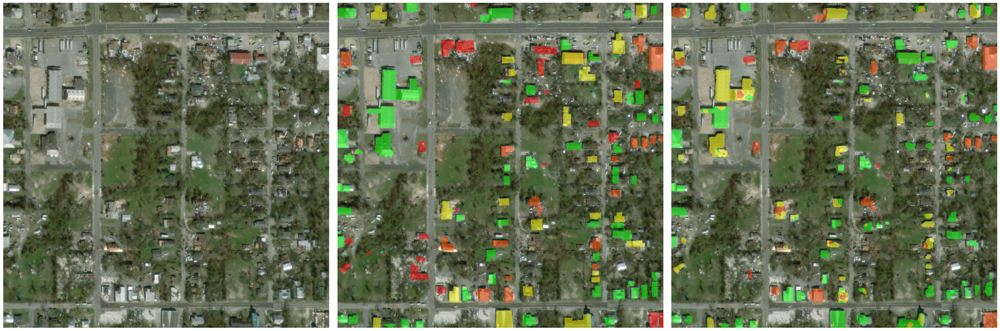

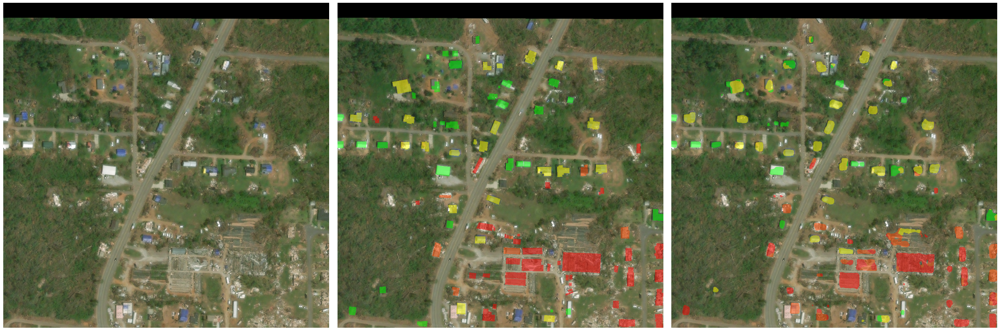

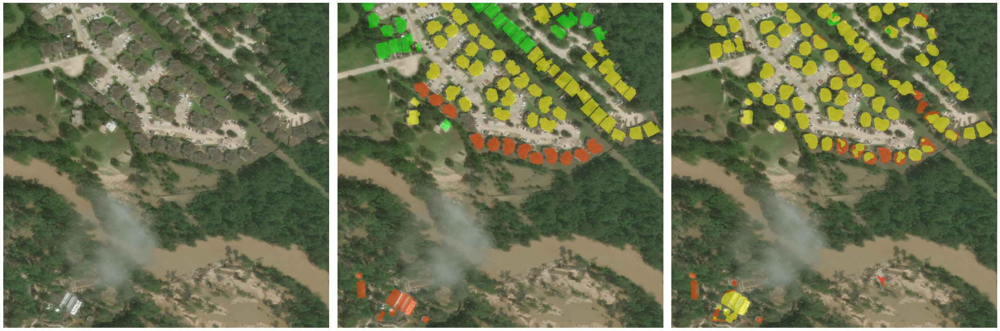

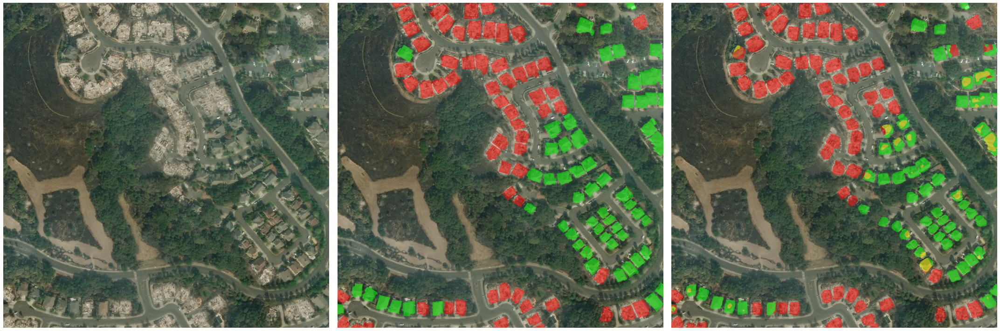

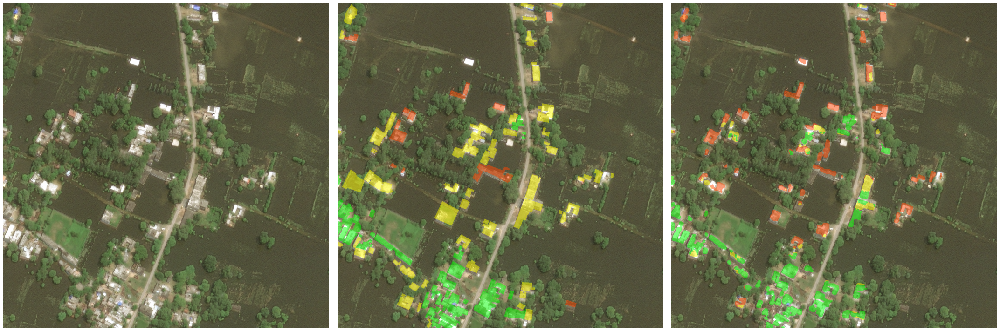

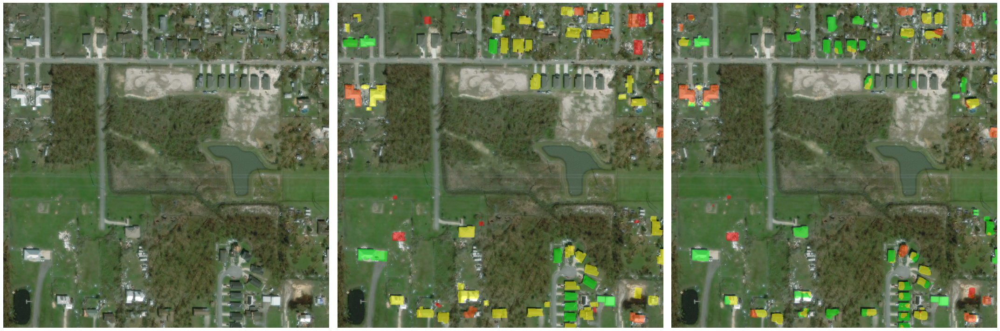

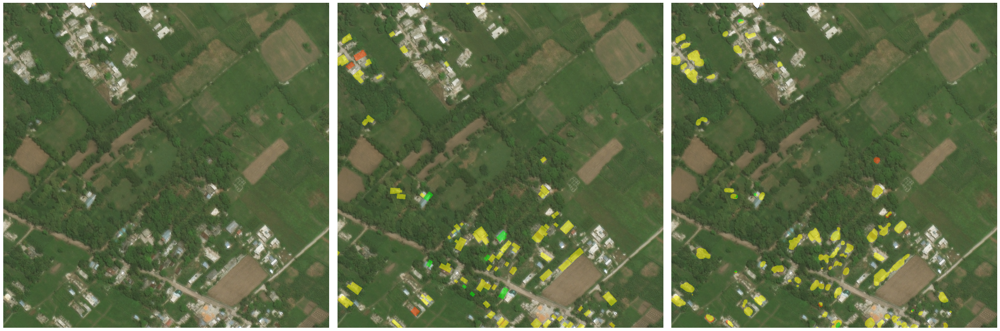

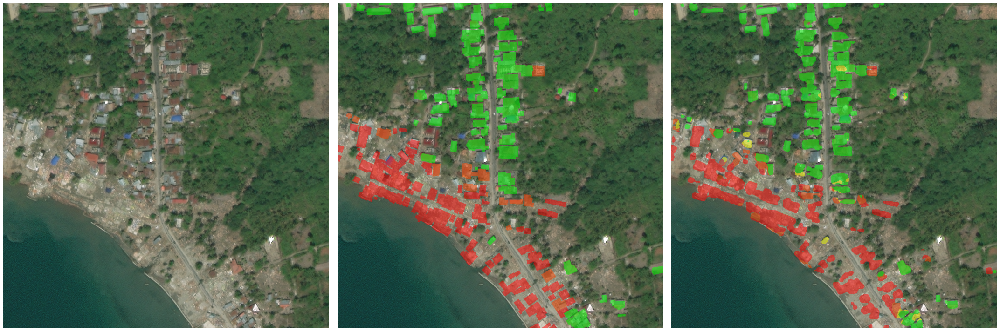

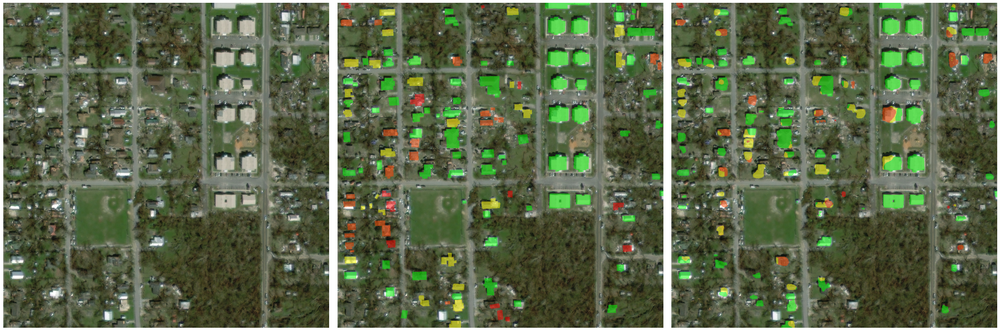

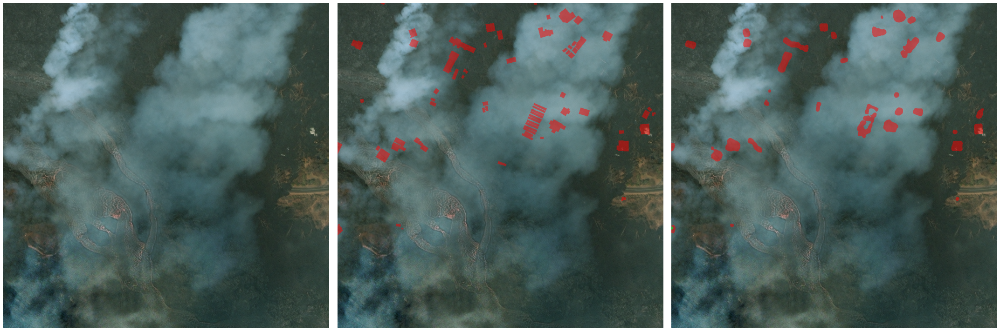

In [ ]:
model = siamese_b4_unet64().cuda()
model.load_state_dict(torch.load(best_checkpoint_fname)["model_state_dict"])

for i in range(len(holdout_mask_post)):
    gt_mask = read_mask(holdout_mask_post[i])
    image_pre = read_image_rgb(holdout_img_pre[i])
    image_post = read_image_rgb(holdout_img_post[i])
    pred_mask = predict(model, image_pre, image_post)
    
    show_predictions(image_post, gt_mask, pred_mask)
    
del model

In [ ]:
best_checkpoint_fname

'logs/b4-siamese/checkpoints/best.pth'